##### Copyright 2018 Google LLC.

Licensed under the Apache License, Version 2.0 (the "License");

In [0]:
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# Decomposed Feature Visualization (rough)

Decomposed feature visualization is a techhnique for understanding the *mechanics* of how neural network features operate. This is a very early experiment with them.




## Install, Import, Load Model

In [0]:
# Install Lucid & tensorflow

!pip install --quiet lucid==0.0.5
#!pip install --quiet --upgrade-strategy=only-if-needed git+https://github.com/tensorflow/lucid.git

# %tenorflow_version only works on colab
%tenorflow_version 1.x

In [0]:
# Imports

import numpy as np
import tensorflow as tf
assert tf.__version__.startswith('1')

import lucid.modelzoo.vision_models as models
from lucid.misc.io import show
import lucid.optvis.objectives as objectives
import lucid.optvis.param as param
import lucid.optvis.render as render
import lucid.optvis.transform as transform

In [0]:
import scipy.ndimage as nd

In [0]:
# Let's import a model from the Lucid modelzoo!

model = models.InceptionV1()
model.load_graphdef()

In [0]:
def hidden_opt(model, layer, obj, W, require_pos=False):
  with tf.Graph().as_default(), tf.Session() as sess:
    
    t_input = tf.placeholder("float32", [1, None, None, 3])
    T = render.import_model(model, t_input, t_input)
    loss = obj(T)
    t_layer = T(layer)
    vecs = 0.1*np.random.randn(1, W, W, t_layer.shape[-1])
    t_layer_grad = tf.gradients(loss, t_layer)[0]

    for i in range(1000):
      if i % 250 == 0: print loss.eval({t_layer: vecs}), 
      vecs += 0.1 * t_layer_grad.eval({t_layer: vecs})
      if require_pos:
        vecs = np.maximum(0, vecs)
    print ""
      
    return vecs


In [0]:
def decomposed_vis(layer, obj, W=8, W2=32):
  vecs = hidden_opt(model, layer, obj, W=W)
  vecs_flat = vecs.reshape([-1, vecs.shape[-1]])
  
  mags = np.sqrt((vecs[0]**2).sum(2))

  param_f = lambda: param.image(W2, batch=W*W)
  obj = objectives.Objective.sum([
      objectives.direction(layer, vec, batch=n)
      for n, vec in enumerate(vecs_flat)
  ])

  imgs = render.render_vis(model, obj, param_f, thresholds=(512,))
  
  imgs_ = np.pad(imgs[0].reshape([W,W,W2,W2,3]), [(0,0), (0,0), (0,1), (0,1), (0,0)], mode='constant', constant_values=(1,))
  img_grid = np.hstack(np.hstack(imgs_))
  mags_grid = np.hstack(np.hstack(
      np.pad(
          nd.zoom(mags.reshape([W,W,1,1])/mags.max(), [1, 1, W2, W2], order=0)[..., None]
          , [(0,0), (0,0), (0,1), (0,1), (0,0)], mode='constant', constant_values=(1,))

  ))
  #show(mags_grid)
  #show(img_grid)
  show(img_grid * mags_grid  + 0.8*(1-mags_grid) )

In [8]:
for node in model.graph_def.node:
  if not "/" in node.name and not "_" in node.name:
    print node.name

input
conv2d0
maxpool0
localresponsenorm0
conv2d1
conv2d2
localresponsenorm1
maxpool1
mixed3a
mixed3b
maxpool4
mixed4a
mixed4b
mixed4c
mixed4d
mixed4e
maxpool10
mixed5a
mixed5b
avgpool0
nn0
softmax0
nn1
softmax1
softmax2
output
output1
output2


512 [5920.5444]



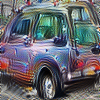

[-0.5783826] [27.253613] [55.562912] [83.730484] 
512 712.68896



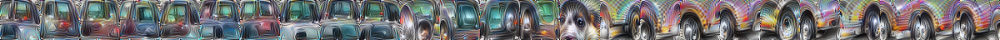


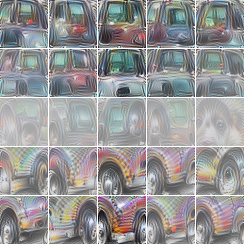

In [7]:
obj = objectives.neuron("mixed4c_pre_relu", 447)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4b", obj, W=5, W2=48)

512 [5289.624]



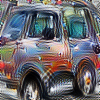

[-2.8396463] [47.62098] [82.608086] [117.355286] 
512 1397.7031



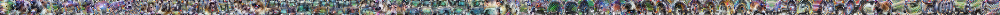


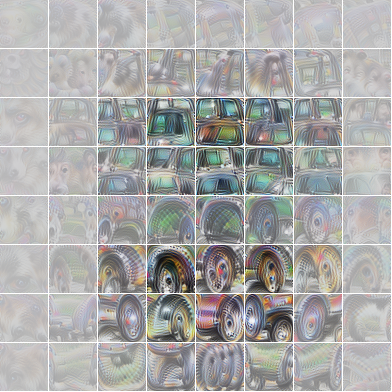

In [9]:
obj = objectives.neuron("mixed4c_pre_relu", 447)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=8, W2=48)

512 [5088.3745]



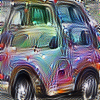

[-5.9211655] [41.485485] [93.910065] [175.572] 
512 1621.6318



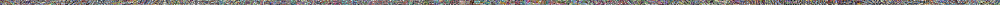


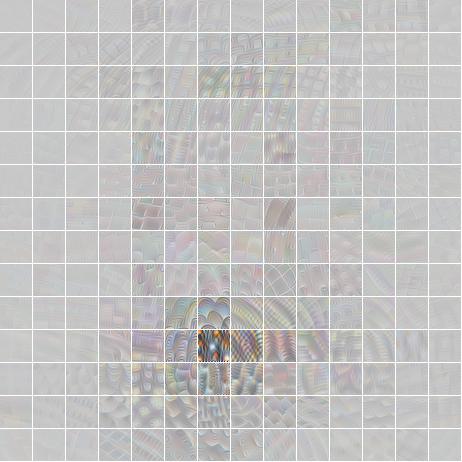

In [10]:
obj = objectives.neuron("mixed4c_pre_relu", 447)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed3a", obj, W=14, W2=32)

512 [4948.5024]



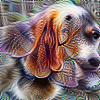

[0.07394248] [39.683586] [77.32095] [114.89942] 
512 651.6599



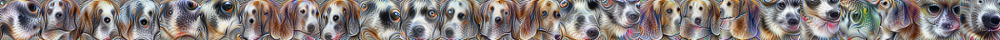


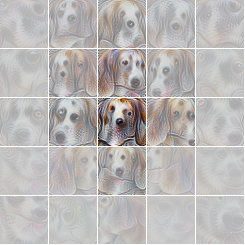

In [47]:
|fobj = objectives.neuron("mixed4d_pre_relu", 426)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4c", obj, W=5, W2=48)

512 [3244.923]



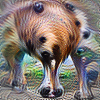

[0.37219653] [14.156713] [25.67627] [37.20147] 
512 371.83102



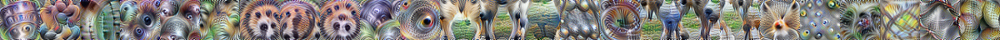


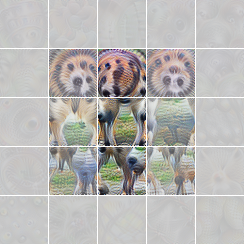

In [53]:
obj = objectives.neuron("mixed4b_pre_relu", 368)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=5, W2=48)

512 [2491.0662]



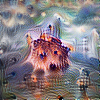

[0.22406384] [17.83633] [32.860977] [47.850792] 
512 384.26587



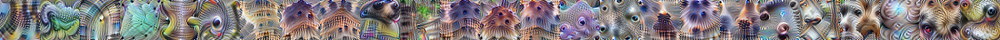


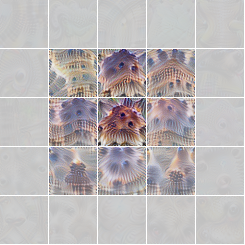

In [54]:
obj = objectives.neuron("mixed4b_pre_relu", 369)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=5, W2=48)

512 [3838.2075]



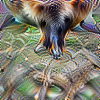

[0.32719594] [13.5257845] [24.346987] [35.177425] 
512 500.67758



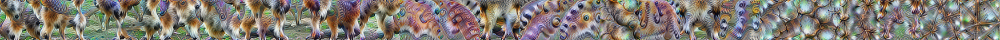


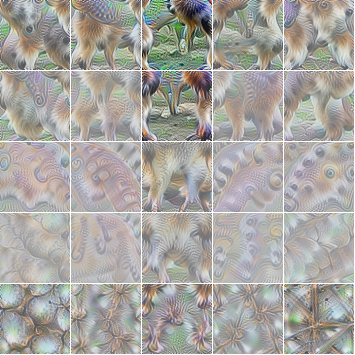

In [9]:
obj = objectives.neuron("mixed4b_pre_relu", 396)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=5, W2=70)

512 [2667.6453]



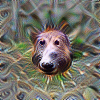

[0.49565056] [12.310391] [22.122395] [31.906187] 
512 409.88477



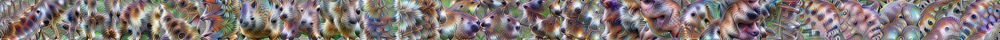


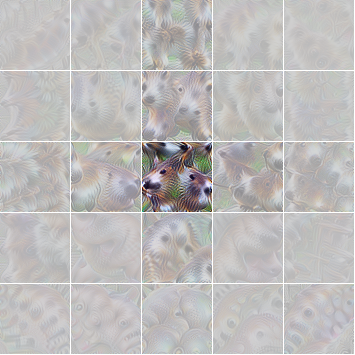

In [10]:
obj = objectives.neuron("mixed4b_pre_relu", 402)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=5, W2=70)

512 [4483.091]



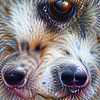

[0.20701264] [19.705093] [36.81204] [53.980072] 
512 749.6432



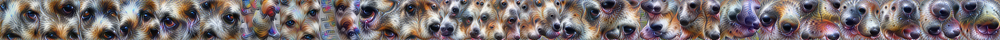


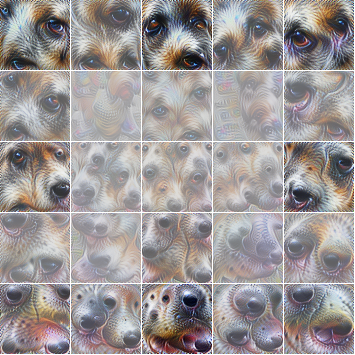

In [11]:
obj = objectives.neuron("mixed4b_pre_relu", 403)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=5, W2=70)

512 [4164.884]



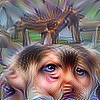

[-0.24503744] [15.056617] [28.254328] [41.40747] 
512 630.4484



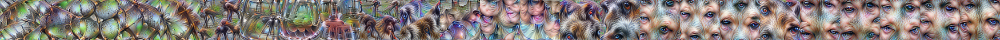


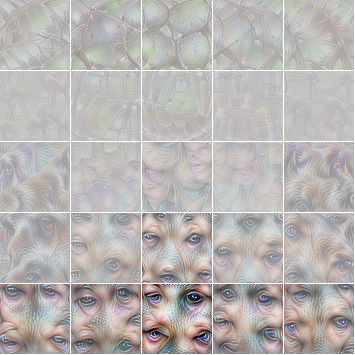

In [12]:
obj = objectives.neuron("mixed4b_pre_relu", 405)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=5, W2=70)

512 [4871.179]



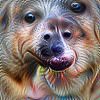

[0.17435488] [18.935804] [35.22211] [51.481693] 
512 821.6135



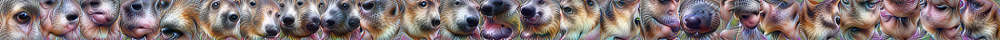


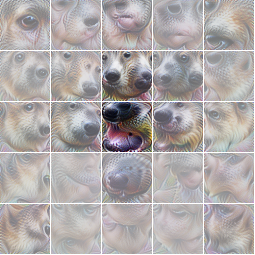

In [21]:
obj = objectives.neuron("mixed4b_pre_relu", 409)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=5, W2=50)

512 [3360.9058]



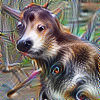

[-0.01797339] [11.983153] [21.800112] [31.748919] 
512 509.64902



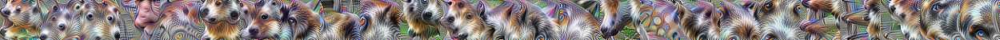


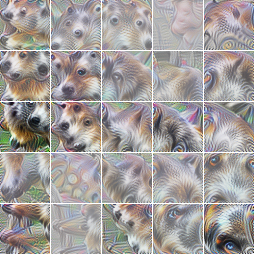

In [20]:
obj = objectives.neuron("mixed4b_pre_relu", 414)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=5, W2=50)

512 [4555.3804]



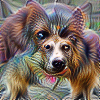

[-0.15576442] [28.00195] [53.289303] [78.57025] 
512 942.2225



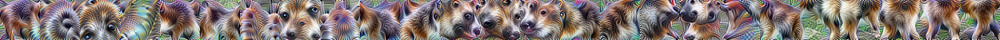


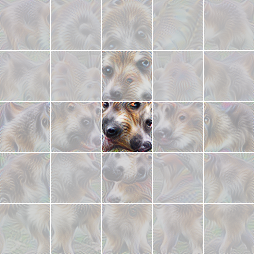

In [19]:
obj = objectives.neuron("mixed4b_pre_relu", 418)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=5, W2=50)

512 [5914.3447]



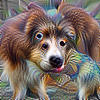

[-0.0299177] [27.79535] [53.048737] [78.327034] 
512 930.49243



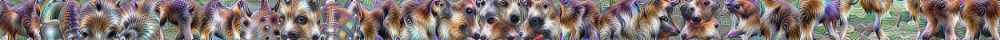


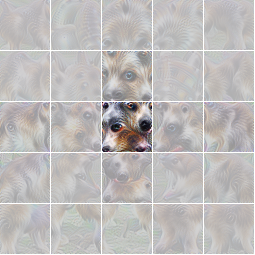

In [22]:
obj = objectives.neuron("mixed4b_pre_relu", 418)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=5, W2=50)

512 [5199.784]



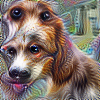

[0.0800992] [19.527641] [36.2039] [52.909515] 
512 755.61194



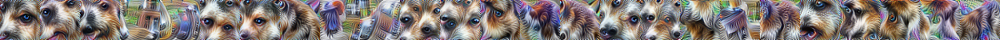


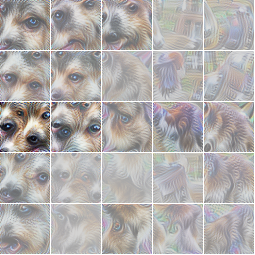

In [23]:
obj = objectives.neuron("mixed4b_pre_relu", 429)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=5, W2=50)

512 [3142.1343]



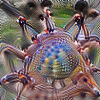

[0.28221816] [12.072634] [22.223206] [32.332207] 
512 597.3205



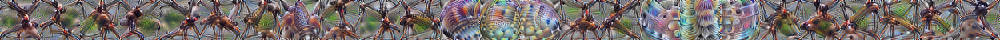


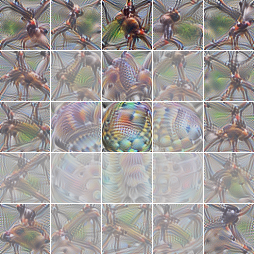

In [24]:
obj = objectives.neuron("mixed4b_pre_relu", 437)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=5, W2=50)

512 [3270.2854]



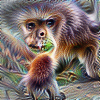

[0.06421056] [15.12474] [29.023287] [42.880196] 
512 322.58386



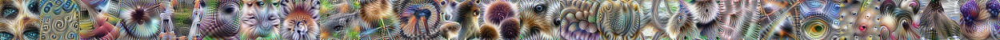


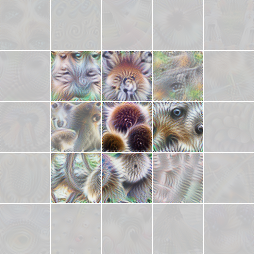

In [7]:
obj = objectives.neuron("mixed4b_pre_relu", 450)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=5, W2=50)

512 [3405.1697]



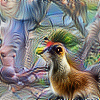

[-0.7962754] [23.149366] [44.361168] [66.311935] 
512 514.877



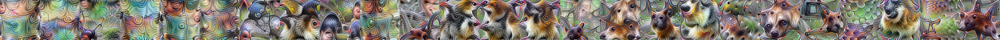


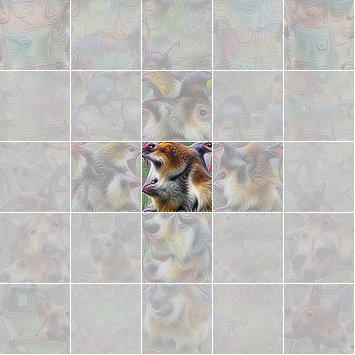

In [8]:
obj = objectives.neuron("mixed4c_pre_relu", 409)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4b", obj, W=5, W2=70)

512 [3191.9436]



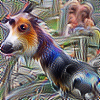

[-0.22031027] [14.297702] [26.172873] [38.086796] 
512 391.03894



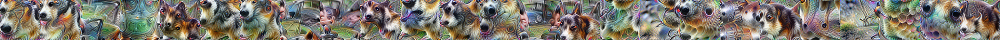


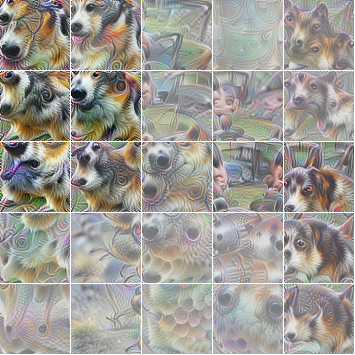

In [9]:
obj = objectives.neuron("mixed4c_pre_relu", 418)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4b", obj, W=5, W2=70)

512 [2753.4014]



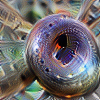

[-0.05936106] [12.628906] [24.137106] [35.597] 
512 319.17712



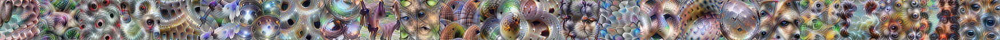


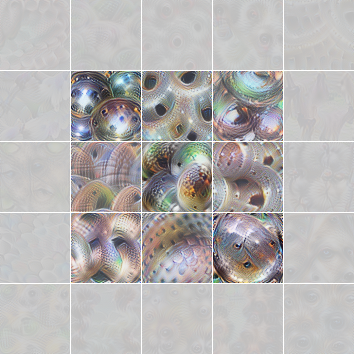

In [18]:
obj = objectives.neuron("mixed4b_pre_relu", 462)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=5, W2=70)

512 [2746.9575]



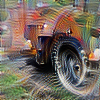

[-0.24139129] [18.711418] [34.711914] [50.716488] 
512 418.32898



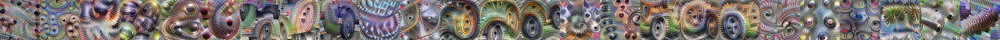


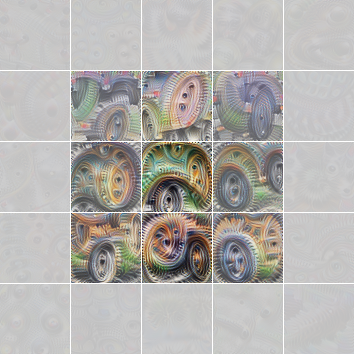

In [57]:
obj = objectives.neuron("mixed4b_pre_relu", 373)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=5, W2=70)

512 [3042.0288]



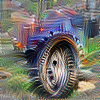

[-0.06549181] [18.982788] [35.06047] [51.15104] 
512 456.83997



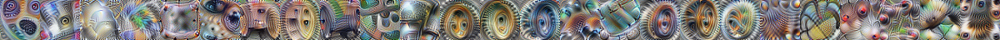


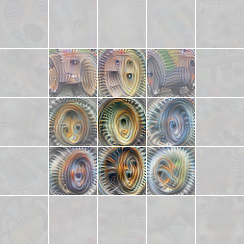

In [55]:
obj = objectives.neuron("mixed4b_pre_relu", 373)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=5, W2=48)

512 [5159.9834]



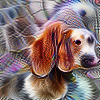

 [-4.6794705] [52.082783] [88.43633] [124.26673] 
512 1134.271



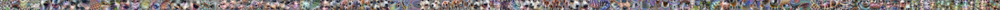


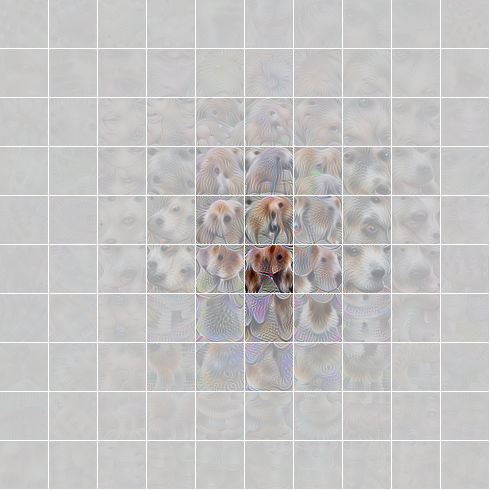

In [52]:
obj = objectives.neuron("mixed4d_pre_relu", 426)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("mixed4a", obj, W=10, W2=48)

512 [4599.4194]



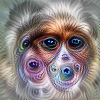

[-0.34192824] [27.047497] [51.625256] [76.255486] 
512 814.5455



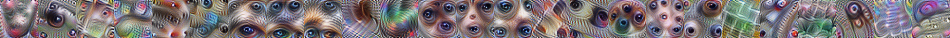


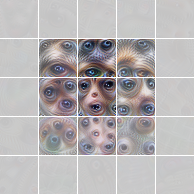

In [50]:
obj = objectives.neuron("mixed4a_pre_relu", 368)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=38)

512 [5427.123]



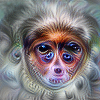

[-0.48527247] [27.11984] [51.837227] [76.59127] 
512 726.41345



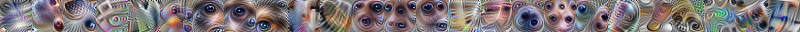


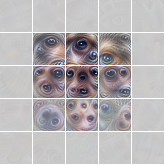

In [48]:
obj = objectives.neuron("mixed4a_pre_relu", 368)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [2297.1968]



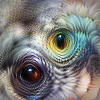

[-0.0648718] [19.397154] [37.41374] [55.415348] 
512 624.3943



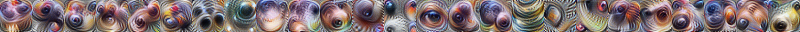


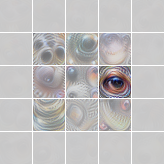

In [11]:
obj = objectives.neuron("mixed4a_pre_relu", 460)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [1931.3134]



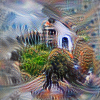

[0.23064563] [23.879513] [45.882442] [67.87124] 
512 555.57635



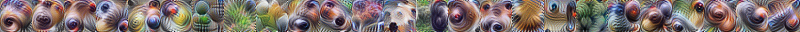


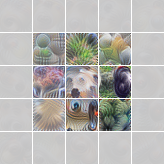

In [10]:
obj = objectives.neuron("mixed4a_pre_relu", 475)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [1745.6112]



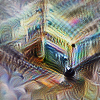

[0.17473549] [20.072954] [38.778442] [57.439262] 
512 314.85904



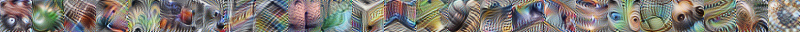


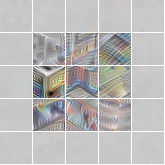

In [8]:
obj = objectives.neuron("mixed4a_pre_relu", 455)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [2629.794]



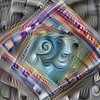

[0.21602516] [11.583387] [21.114212] [30.644304] 
512 529.1863



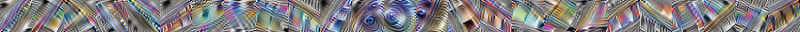


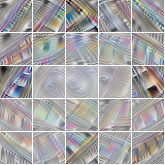

In [7]:
obj = objectives.neuron("mixed4a_pre_relu", 443)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [3772.6838]



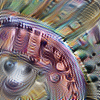

[-0.1787216] [9.528883] [16.943613] [24.247198] 
512 905.1608



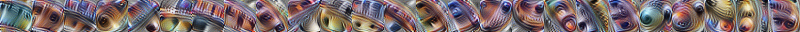


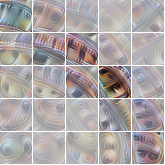

In [14]:
obj = objectives.neuron("mixed4a_pre_relu", 426)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [3121.1353]



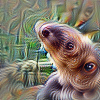

[0.00719921] [25.367666] [48.19033] [71.033295] 
512 503.2522



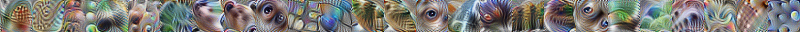


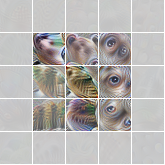

In [42]:
obj = objectives.neuron("mixed4a_pre_relu", 371)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [3168.1628]



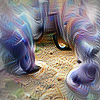

[0.57510674] [24.82596] [46.552643] [68.34562] 
512 507.82306



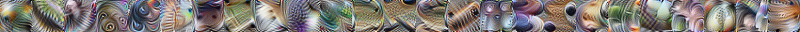


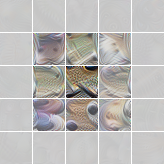

In [49]:
obj = objectives.neuron("mixed4a_pre_relu", 372)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [3070.728]



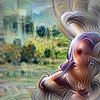

[-0.06418443] [28.307547] [53.46128] [78.73724] 
512 501.6889



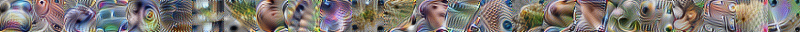


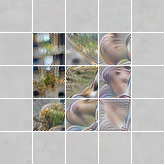

In [35]:
obj = objectives.neuron("mixed4a_pre_relu", 374)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [3330.3484]



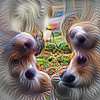

[-0.00951466] [17.531813] [32.74345] [48.010677] 
512 467.01202



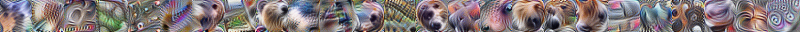


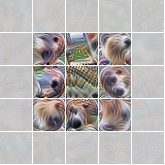

In [43]:
obj = objectives.neuron("mixed4a_pre_relu", 375)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [3866.8867]



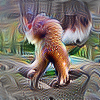

[-0.5437354] [30.695196] [58.576145] [86.52927] 
512 645.2164



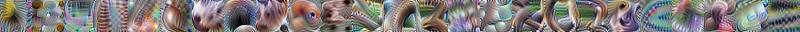


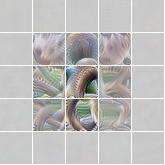

In [36]:
obj = objectives.neuron("mixed4a_pre_relu", 383)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [3329.6033]



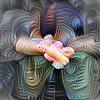

[-0.03198454] [22.326384] [41.84923] [61.446278] 
512 514.9338



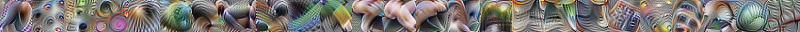


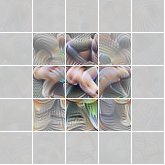

In [37]:
obj = objectives.neuron("mixed4a_pre_relu", 386)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [2488.431]



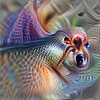

[0.07138123] [21.141193] [39.561634] [57.986786] 
512 443.3991



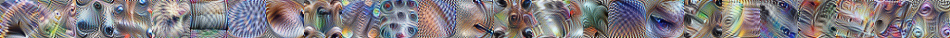


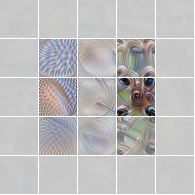

In [44]:
obj = objectives.neuron("mixed4a_pre_relu", 389)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=38)

512 [2607.3064]



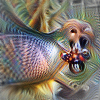

[-0.28256202] [20.985905] [39.390106] [57.799294] 
512 478.9345



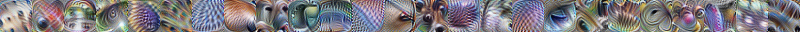


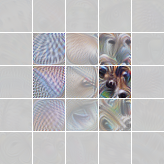

In [38]:
obj = objectives.neuron("mixed4a_pre_relu", 389)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [6638.676]



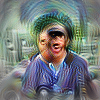

[-0.63946664] [74.706894] [145.8053] [216.96138] 
512 737.2148



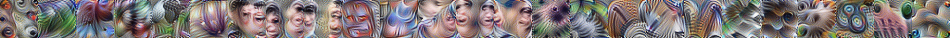


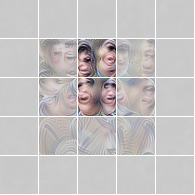

In [39]:
obj = objectives.neuron("mixed4a_pre_relu", 391)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=38)

512 [5348.0854]



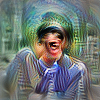

[-0.74396044] [74.49679] [145.59766] [216.71626] 
512 792.11835



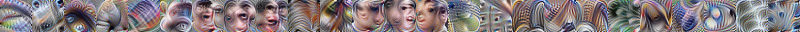


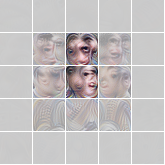

In [40]:
obj = objectives.neuron("mixed4a_pre_relu", 391)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [3383.6567]



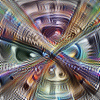

[0.32338637] [18.938078] [35.517536] [52.08198] 
512 681.6991



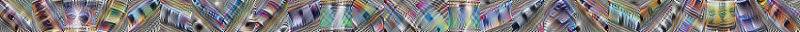


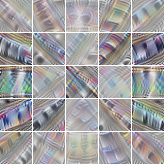

In [59]:
obj = objectives.neuron("mixed4a_pre_relu", 397)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [3189.899]



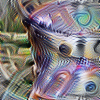

[0.03085956] [13.365607] [23.686354] [33.939785] 
512 1194.0269



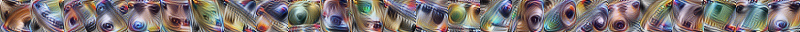


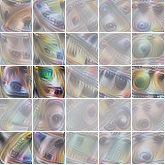

In [18]:
obj = objectives.neuron("mixed4a_pre_relu", 409)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [2473.8054]



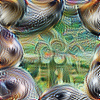

[0.68488955] [12.153672] [21.703093] [31.147547] 
512 981.6162



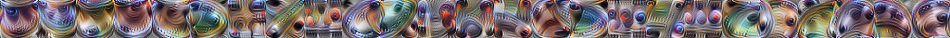


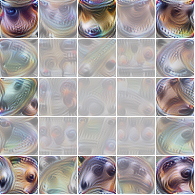

In [22]:
obj = objectives.neuron("mixed4a_pre_relu", 408)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=38)

512 [2658.7944]



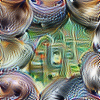

[0.7928688] [12.229861] [21.781069] [31.226694] 
512 1125.5286



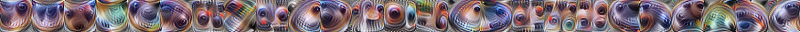


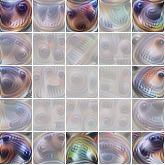

In [19]:
obj = objectives.neuron("mixed4a_pre_relu", 408)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [2728.9512]



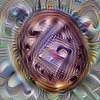

[0.06034447] [14.722796] [27.360315] [39.986626] 
512 693.60034



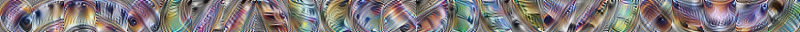


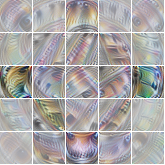

In [45]:
obj = objectives.neuron("mixed4a_pre_relu", 402)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [3321.3325]



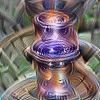

[-0.02896704] [19.680662] [37.039642] [54.39272] 
512 798.3628



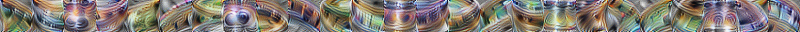


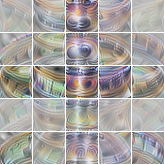

In [46]:
obj = objectives.neuron("mixed4a_pre_relu", 423)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 [2232.0295]



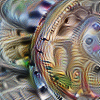

[0.01840711] [13.035285] [23.652243] [34.135235] 
512 1019.05347



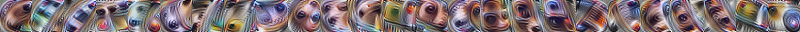


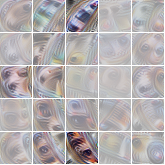

In [17]:
obj = objectives.neuron("mixed4a_pre_relu", 417)
render.render_vis(model, obj, lambda: param.image(100))
decomposed_vis("maxpool4", obj, W=5, W2=32)

512 1288.9688



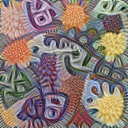

In [9]:
_ = render.render_vis(model, "mixed4a_pre_relu:476")

512 [672.3662]



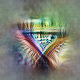

[-0.11067072] [86.355125] [170.51508] [254.75972] 
512 435.52533



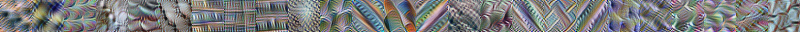


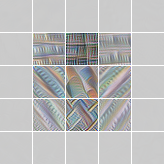

In [41]:
obj = objectives.neuron("mixed3a_pre_relu", 188)
render.render_vis(model, obj, lambda: param.image(80))
decomposed_vis("maxpool1", obj, W=5, W2=32)

512 [579.0347]



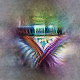

[-0.08502422] [51.642185] [99.93456] [148.23859] 
512 571.719



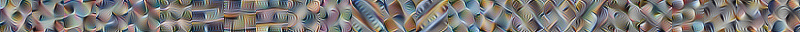


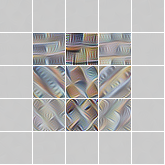

In [34]:
obj = objectives.neuron("mixed3a_pre_relu", 188)
render.render_vis(model, obj, lambda: param.image(80))
decomposed_vis("maxpool1", obj, W=5, W2=32)

[-0.4931006] [18.95018] [34.11355] [49.26719] 
512 674.20184



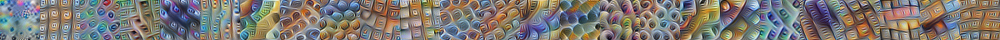


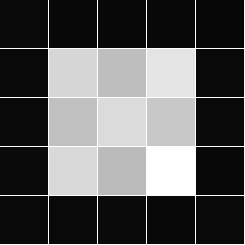


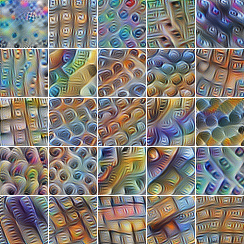


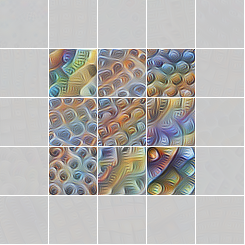

In [19]:
obj = objectives.neuron("mixed3b_pre_relu", 318)
decomposed_vis("mixed3a", obj, W=5, W2=48)

512 [1682.0072]



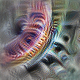

[-0.76788425] [49.55262] [95.37189] [141.20833] 
512 639.98145



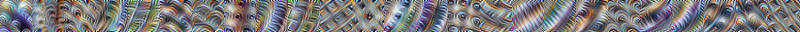


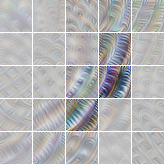

In [58]:
obj = objectives.neuron("mixed3b_pre_relu", 342)
render.render_vis(model, obj, lambda: param.image(80))
decomposed_vis("mixed3a", obj, W=5, W2=32)

[0.18203844] [25.392897] [47.812107] [70.320496] 
512 1006.4719



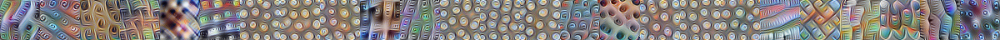


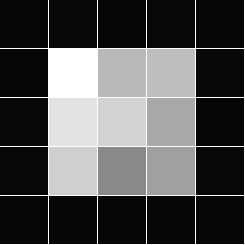


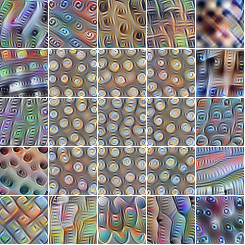


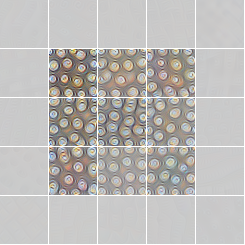

In [17]:
obj = objectives.neuron("mixed3b_pre_relu", 316)
decomposed_vis("mixed3a", obj, W=5, W2=48)

512 [1267.8467]



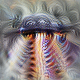

[-0.23418218] [19.550758] [35.001556] [50.362965] 
512 904.236



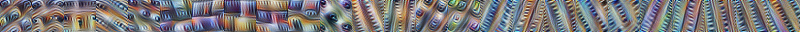


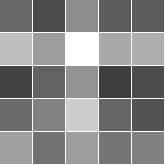


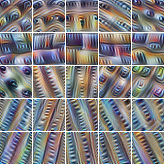


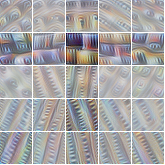

In [15]:
obj = objectives.neuron("mixed3b_pre_relu", 320)
render.render_vis(model, obj, lambda: param.image(80))
decomposed_vis("mixed3a", obj, W=5, W2=32)

512 [2043.5299]



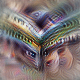

[-0.5394805] [23.07312] [42.313976] [61.448772] 
512 1018.1162



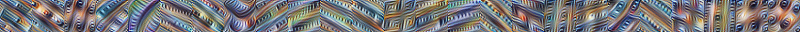


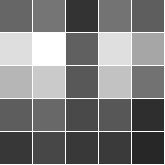


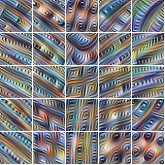


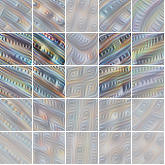

In [14]:
obj = objectives.neuron("mixed3b_pre_relu", 339)
render.render_vis(model, obj, lambda: param.image(80))
decomposed_vis("mixed3a", obj, W=5, W2=32)

[-0.4086998] [25.034378] [45.71674] [66.32295] 
512 1025.3914



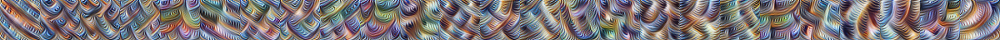


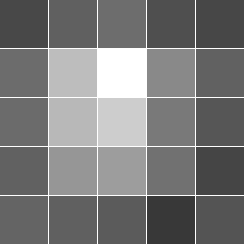


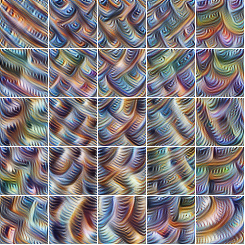


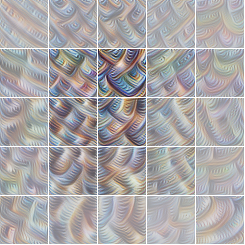

In [8]:
obj = objectives.neuron("mixed3b_pre_relu", 367)
decomposed_vis("mixed3a", obj, W=5, W2=48)

512 [1465.3738]



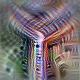

[-0.35458434] [19.131765] [34.565754] [49.921234] 
512 936.8495



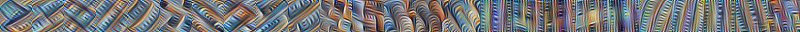


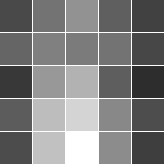


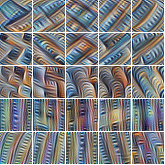


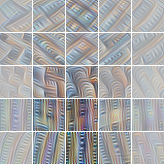

In [17]:
obj = objectives.neuron("mixed3b_pre_relu", 344)
render.render_vis(model, obj, lambda: param.image(80))
decomposed_vis("mixed3a", obj, W=5, W2=32)

512 [444.72144]



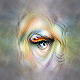

[-0.48838598] [60.01479] [116.77704] [173.53343] 
512 590.5175



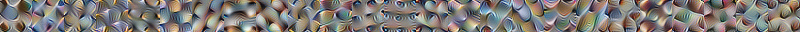


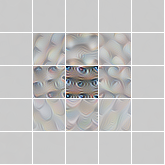

In [23]:
obj = objectives.neuron("mixed3a_pre_relu", 174)
render.render_vis(model, obj, lambda: param.image(80))
decomposed_vis("maxpool1", obj, W=5, W2=32)

[-0.31444335] [63.38946] [123.50652] [183.62169] 
512 672.0368



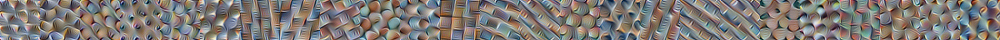


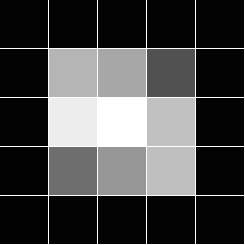


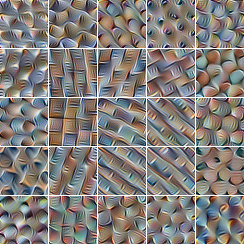


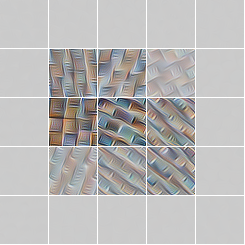

In [12]:
obj = objectives.neuron("mixed3a_pre_relu", 149)
decomposed_vis("maxpool1", obj, W=5, W2=48)

[-0.48851967] [46.67312] [90.73688] [134.84222] 
512 608.87915



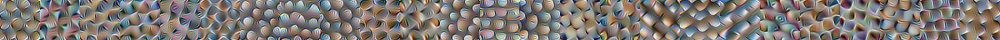


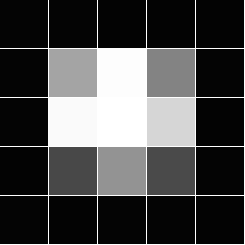


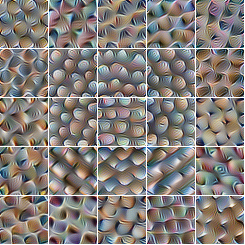


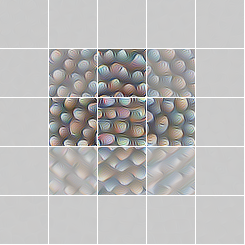

In [11]:
obj = objectives.neuron("mixed3a_pre_relu", 177)
decomposed_vis("maxpool1", obj, W=5, W2=48)

[-0.32742932] [20.790764] [38.629528] [56.37598] 
512 710.4025



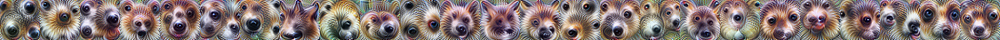


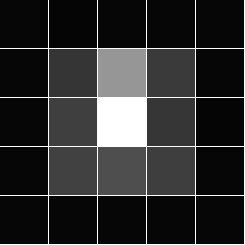


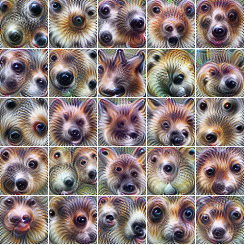


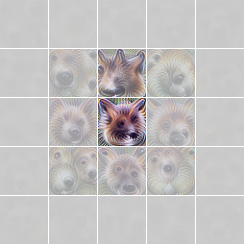

In [10]:
obj = objectives.neuron("mixed4b_pre_relu", 175)
decomposed_vis("mixed4a", obj, W=5, W2=48)

512 [3725.3474]



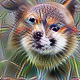

[0.07476339] [14.936309] [27.064476] [39.07512] 
512 855.62634



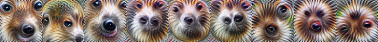


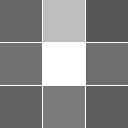


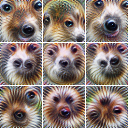


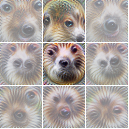

In [18]:
obj = objectives.neuron("mixed4b_pre_relu", 176)
render.render_vis(model, obj, lambda: param.image(80))
decomposed_vis("mixed4a", obj, W=3, W2=42)

[0.1318711] [13.673563] [24.048182] [34.356586] 
512 278.79385



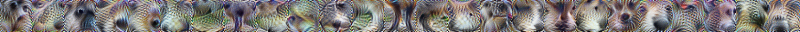


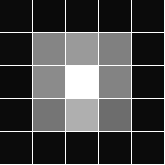


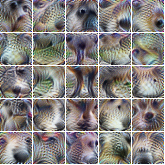


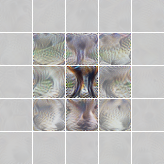

In [16]:
obj = objectives.neuron("mixed4b_pre_relu", 235)
decomposed_vis("mixed4a", obj, W=5, W2=32)

[-0.02376008] [15.242497] [27.379873] [39.429676] 
512 261.1907



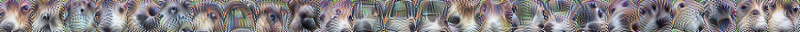


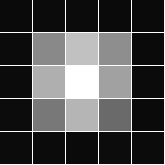


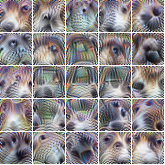


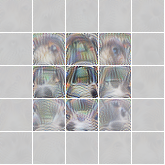

In [19]:
obj = objectives.neuron("mixed4b_pre_relu", 237)
decomposed_vis("mixed4a", obj, W=5, W2=32)

[0.7051698] [16.485058] [31.993143] [47.500263] 
512 138.37042



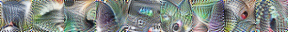


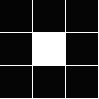


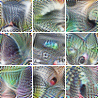


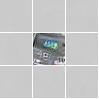

In [17]:
obj = objectives.neuron("mixed4c_pre_relu", 8)
decomposed_vis("mixed4b", obj, W=3, W2=32)

[0.8526461] [15.270745] [28.0152] [40.75976] 
512 231.13649



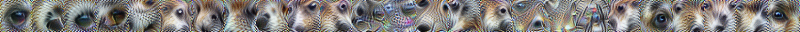


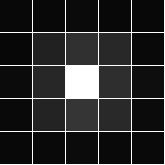


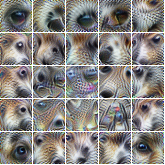


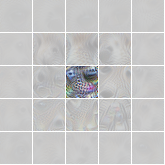

In [18]:
obj = objectives.neuron("mixed4c_pre_relu", 8)
decomposed_vis("mixed4a", obj, W=5, W2=32)

[0.38001198] [18.185] [35.826694] [53.467373] 
512 431.58755



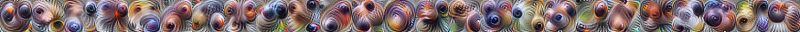


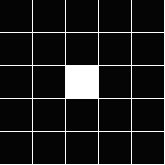


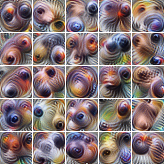


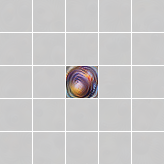

In [26]:
obj = objectives.neuron("mixed4a_pre_relu", 36)
decomposed_vis("maxpool4", obj, W=5, W2=32)

[0.02971543] [8.785434] [24.014843] [40.957222] 
512 674.4531



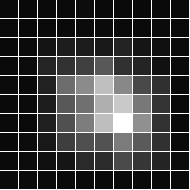


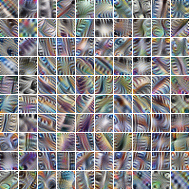


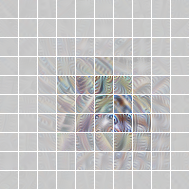

In [12]:
obj = objectives.neuron("mixed4a_pre_relu", 36)
decomposed_vis("mixed3a", obj, W=10, W2=18)

[0.20501895] [19.109838] [36.76633] [54.410286] 
512 139.7491



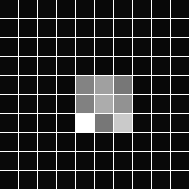


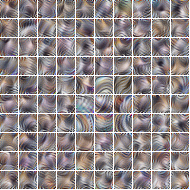


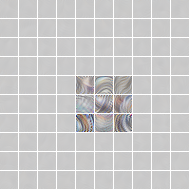

In [13]:
obj = objectives.neuron("mixed4a_pre_relu", 36)
decomposed_vis("mixed3b", obj, W=10, W2=18)

0.07912122 0.8464691 2.0357249 3.9925823 
512 373.9257



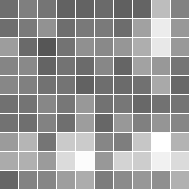


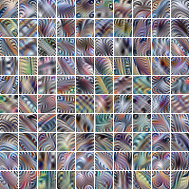


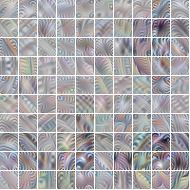

In [8]:
obj = objectives.channel("mixed4a_pre_relu", 36)
decomposed_vis("mixed3a", obj, W=10, W2=18)

0.1286154 2.5634048 5.0060015 7.126855 
512 562.396



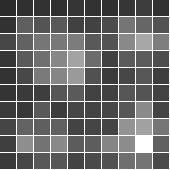


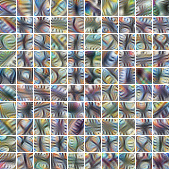


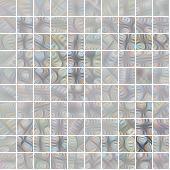

In [9]:
obj = objectives.channel("mixed4a_pre_relu", 11)
decomposed_vis("mixed3a", obj, W=10, W2=16)

0.099485815 2.3148599 4.750007 6.9077325 
512 528.6465



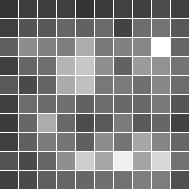


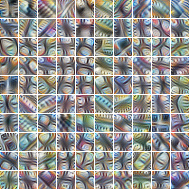


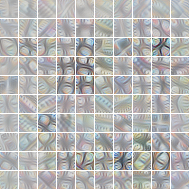

In [19]:
obj = objectives.channel("mixed4a_pre_relu", 11)
decomposed_vis("mixed3a", obj, W=10, W2=18)

[0.00690335] [16.094152] [30.655743] [45.56154] 
512 674.91614



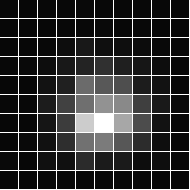


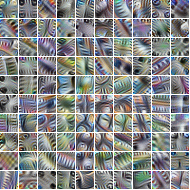


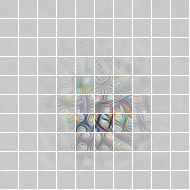

In [10]:
obj = objectives.neuron("mixed4a_pre_relu", 11)
decomposed_vis("mixed3a", obj, W=10, W2=18)

[-1.7107325] [65.66075] [130.60475] [195.90953] 
512 -107.87578



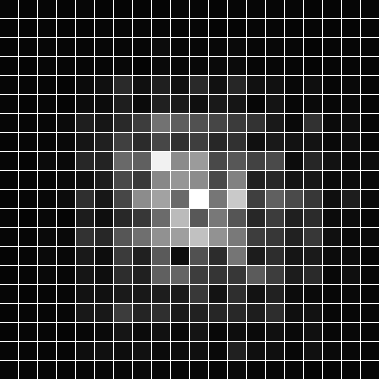


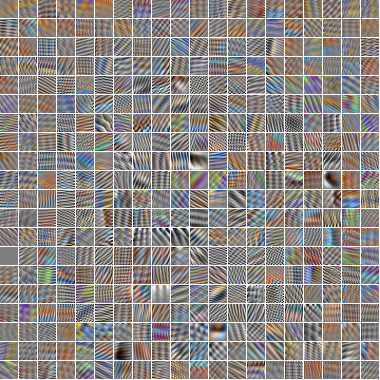


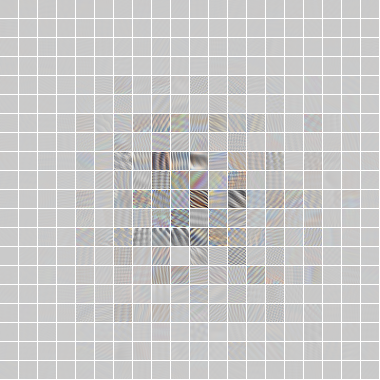

In [11]:
obj = objectives.neuron("mixed4a_pre_relu", 11)
decomposed_vis("conv2d2", obj, W=4*5, W2=18)

[0.06190045] [22.612238] [43.084938] [63.457836] 
8 76.5102



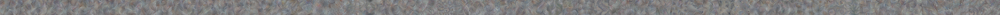


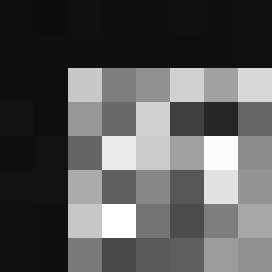


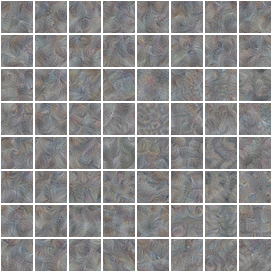


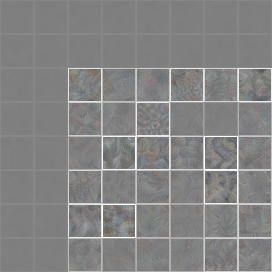

In [14]:
obj = objectives.neuron("mixed4a_pre_relu", 476)
decomposed_vis("mixed3b", obj, W=8, W2=32)

[0.04645811] [22.605408] [43.09341] [63.465565] 
128 193.46898



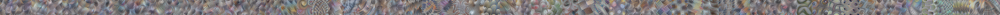


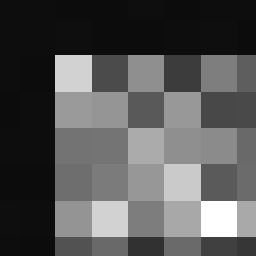


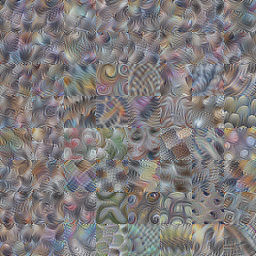


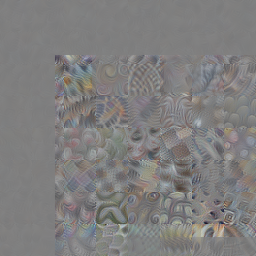

In [34]:
obj = objectives.neuron("mixed4a_pre_relu", 476)
decomposed_vis("mixed3b", obj, W=8, W2=32)

[0.15653779] [14.630148] [28.307514] [42.193756] 
128 729.6647



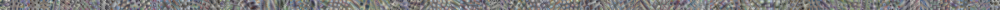


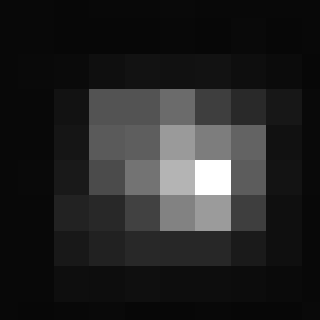


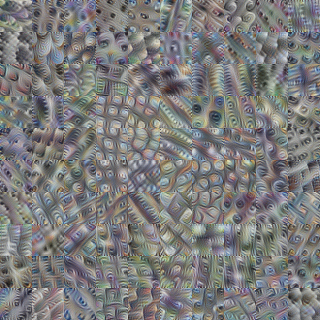


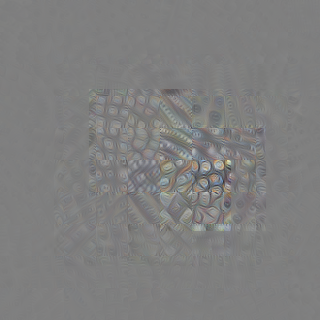

In [36]:
obj = objectives.neuron("mixed4a_pre_relu", 11)
decomposed_vis("mixed3a", obj, W=10, W2=32)

[-1.6092606] [91.624405] [181.80292] [271.14542] 
128 15.953862



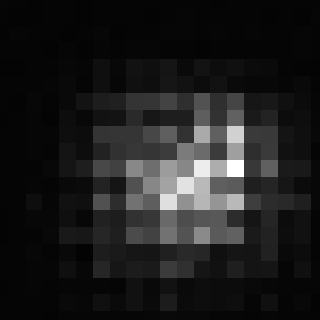


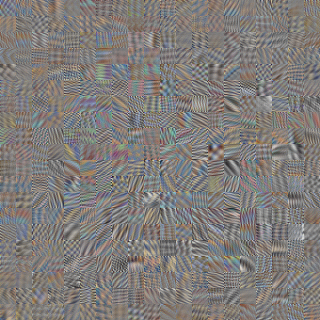


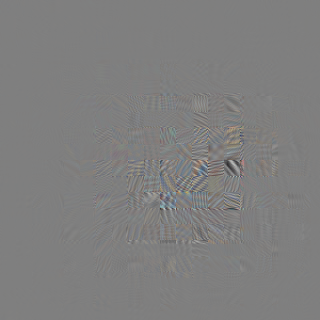

In [37]:
obj = objectives.neuron("mixed4a_pre_relu", 11)
decomposed_vis("conv2d2", obj, W=20, W2=16)

0.1403646 2.4788575 4.946161 7.074747 
(1, 10, 10, 256) (10, 10, 256) float64
512 597.5731



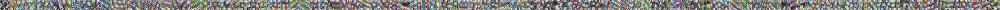


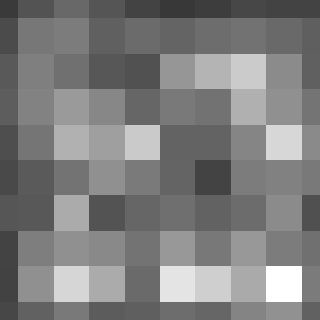


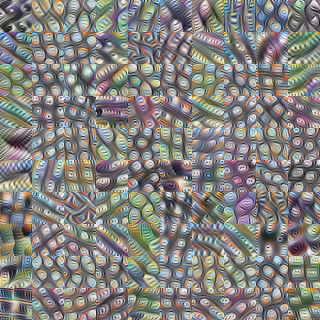


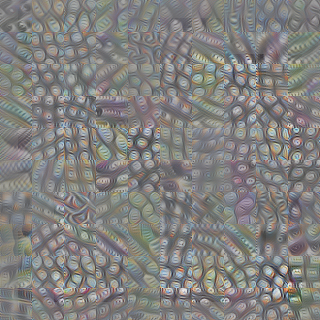

In [11]:
obj = objectives.channel("mixed4a_pre_relu", 11)
decomposed_vis("mixed3a", obj, W=10, W2=32)

0.09984322 2.1868072 4.448259 6.4796953 
(1, 10, 10, 256) (10, 10, 256) float64
512 436.8395



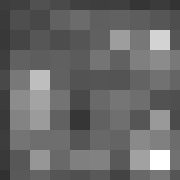


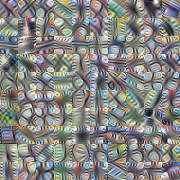


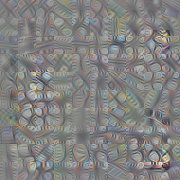

In [13]:
obj = objectives.channel("mixed4a_pre_relu", 11)
decomposed_vis("mixed3a", obj, W=10, W2=18)

0.11798098 2.3361197 4.841185 7.0016384 
(1, 10, 10, 256) (10, 10, 256) float64
512 522.15924



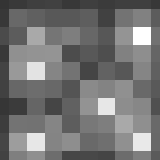


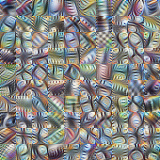


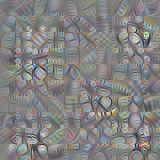

In [14]:
obj = objectives.channel("mixed4a_pre_relu", 11)
decomposed_vis("mixed3a", obj, W=10, W2=16)

0.26394105 2.2250974 3.9075282 5.4626045 
128 111.06346



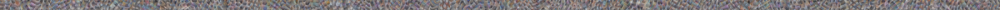


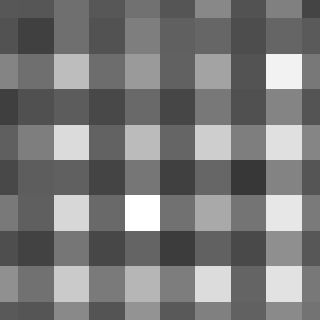


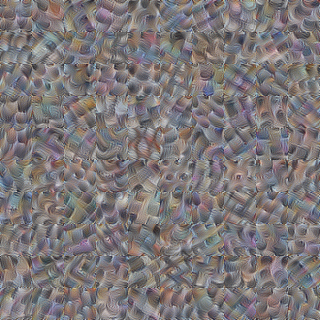


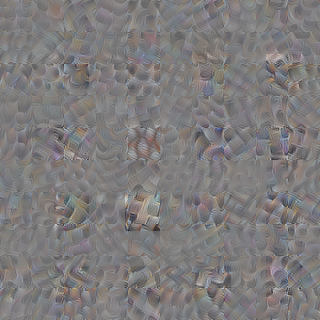

In [41]:
obj = objectives.channel("mixed4a_pre_relu", 1)
decomposed_vis("mixed3b", obj, W=10, W2=32)

0.06347242 2.8805048 5.610231 7.934815 
128 571.7892



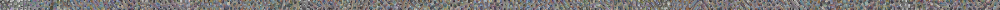


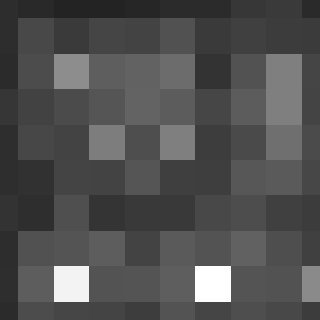


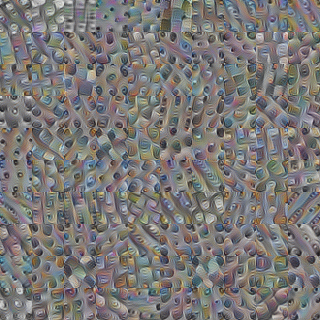


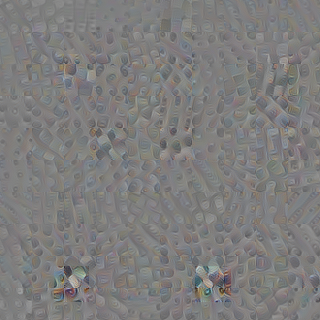

In [40]:
obj = objectives.channel("mixed4a_pre_relu", 1)
decomposed_vis("mixed3a", obj, W=10, W2=32)

In [49]:
obj = objectives.channel("mixed4a_pre_relu", 1)
decomposed_vis("mixed3a", obj, W=10, W2=32)

0.070807226 2.7349432 5.218114 7.41927 
(1, 10, 10, 256) (10, 10, 256) float64


InvalidArgumentError: ignored

In [48]:
obj = objectives.channel("mixed3a_pre_relu", 120)
decomposed_vis("conv2d2", obj, W=10, W2=24)

0.39785308 8.20059 14.49489 20.791489 
(1, 10, 10, 192) (10, 10, 192) float64


InvalidArgumentError: ignored

[0.28909123]
[8.623955]
[17.057825]
[25.491695]
[33.925545]
[42.260395]
[50.6943]
[59.12817]
[67.562]
[75.995865]
512 98.33376



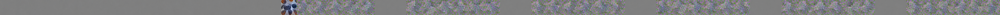


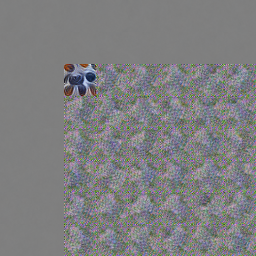

In [10]:
layer = "mixed3b"
obj = objectives.neuron("mixed4a_pre_relu", 476)

vecs = hidden_opt(model, layer, obj, W=8)

param_f = lambda: param.image(32, batch=8*8)
obj = objectives.Objective.sum([
    objectives.direction(layer, vec, batch=n)
    for n, vec in enumerate(vecs.reshape([-1, vecs.shape[-1]]))
])

imgs = render.render_vis(model, obj, param_f)
show(np.hstack(np.hstack(imgs[0].reshape([8,8,32,32,3]))))

512 560.0627



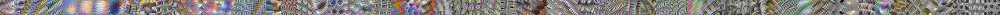


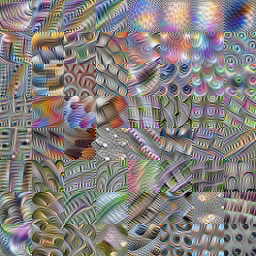

In [9]:
layer = "mixed3a"
obj = objectives.neuron("mixed4a_pre_relu", 476)

vecs = hidden_opt(model, layer, obj, W=8)

param_f = lambda: param.image(32, batch=8*8)
obj = objectives.Objective.sum([
    objectives.direction(layer, vec, batch=n)
    for n, vec in enumerate(vecs.reshape([-1, vecs.shape[-1]]))
])

imgs = render.render_vis(model, obj, param_f)
show(np.hstack(np.hstack(imgs[0].reshape([8,8,32,32,3]))))